In [1]:
# === 0. IMPORTS ===
import os
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import random
from PIL import Image

In [2]:
# === 1. CONFIG ===
PREDICTIONS_CSV = r"C:\Users\Sander\OneDrive - UGent\Semester_2\Masterproef\Thesis_ML\All_results\transformer\predictions_output.csv"  # <-- Predictions bestand
TEST_PATCH_DIR = r"C:\Users\Sander\OneDrive - UGent\Semester_2\Masterproef\Thesis_ML\Roboflow\Raw_July\Definitief_29_04\Test_dataset\test_v5_resize"     # <-- Jouw test patches folder

# === 2. DATA LADEN ===
df = pd.read_csv(PREDICTIONS_CSV)
print(f"Loaded {len(df)} predictions.")

Loaded 2200 predictions.


In [ ]:

# ==========================================================================================
# 3. ALGEMENE METRICS
# ==========================================================================================
print("\n=== Algemene Modelprestaties ===")
print(f"Accuracy: {accuracy_score(df['true_label'], df['pred_label']):.4f}")
print(f"Macro F1-score: {f1_score(df['true_label'], df['pred_label'], average='macro'):.4f}")
print("\n=== Classificatie Rapport ===")
print(classification_report(df['true_label'], df['pred_label']))

# ==========================================================================================
# 4. CONFUSION MATRIX
# ==========================================================================================
print("\n=== Confusion Matrix ===")
labels_sorted = sorted(df['true_label'].unique())  # Sorteer labels alfabetisch
cm = confusion_matrix(df['true_label'], df['pred_label'], labels=labels_sorted)

plt.figure(figsize=(8,6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=labels_sorted, yticklabels=labels_sorted)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# ==========================================================================================
# 5. FOUTTYPES ANALYSEREN
# ==========================================================================================
print("\n=== Top Fouttypes ===")
fouten = df[df['true_label'] != df['pred_label']]
error_counts = fouten.groupby(['true_label', 'pred_label']).size().sort_values(ascending=False)
print(error_counts.head(10))

# ==========================================================================================
# 6. ZON VS SCHADUW PRESTATIES
# ==========================================================================================
print("\n=== Zon vs Schaduw Analyse ===")
sun_patches = df[df['light_condition_new'] == 'sun']
shadow_patches = df[df['light_condition_new'] == 'shadow']

acc_sun = accuracy_score(sun_patches['true_label'], sun_patches['pred_label'])
acc_shadow = accuracy_score(shadow_patches['true_label'], shadow_patches['pred_label'])

print(f"Accuracy in zon: {acc_sun:.3f}")
print(f"Accuracy in schaduw: {acc_shadow:.3f}")

macroF1_sun = f1_score(sun_patches['true_label'], sun_patches['pred_label'], average='macro')
macroF1_shadow = f1_score(shadow_patches['true_label'], shadow_patches['pred_label'], average='macro')

print(f"Macro F1 in zon: {macroF1_sun:.3f}")
print(f"Macro F1 in schaduw: {macroF1_shadow:.3f}")

# ==========================================================================================
# 7. BRIGHTNESS VS FOUTPROBABILITEIT
# ==========================================================================================
print("\n=== Brightness vs Correctheid Analyse ===")
df['correct'] = df['true_label'] == df['pred_label']

plt.figure(figsize=(8,6))
sns.boxplot(x='correct', y='brightness', data=df)
plt.title('Brightness vs Correctness')
plt.xlabel('Correct Prediction')
plt.ylabel('Brightness')
plt.show()

# ==========================================================================================
# 8. KLASSEN-SPECIFIEKE PROBLEMEN
# ==========================================================================================
print("\n=== Per klasse fouten analyse ===")
for klasse in sorted(df['true_label'].unique()):
    klasse_df = df[df['true_label'] == klasse]
    acc = accuracy_score(klasse_df['true_label'], klasse_df['pred_label'])
    print(f"{klasse}: Accuracy = {acc:.3f} ({len(klasse_df)} patches)")

# ==========================================================================================
# 9. VISUELE INSPECTIE VAN FOUTEN
# ==========================================================================================
print("\n=== Voorbeelden van fouten ===")

sample_fouten = fouten.sample(n=min(10, len(fouten)), random_state=42)

for idx, sample in sample_fouten.iterrows():
    patch_name = sample['patch_filename']
    true_label = sample['true_label']
    pred_label = sample['pred_label']
    light_cond = sample['light_condition_new']
    brightness = sample['brightness']

    # Zoek afbeelding in test folder
    img_path = None
    for folder in os.listdir(TEST_PATCH_DIR):
        folder_path = os.path.join(TEST_PATCH_DIR, folder)
        for img in os.listdir(folder_path):
            if patch_name.split(".")[0] in img:
                img_path = os.path.join(folder_path, img)
                break
        if img_path:
            break
    
    if img_path:
        img = Image.open(img_path)
        plt.figure(figsize=(3,3))
        plt.imshow(img)
        plt.title(f"{patch_name}\nTrue: {true_label} | Pred: {pred_label}\nLight: {light_cond} | Brightness: {brightness:.1f}")
        plt.axis('off')
        plt.show()




=== Confusion Matrix ZON ===


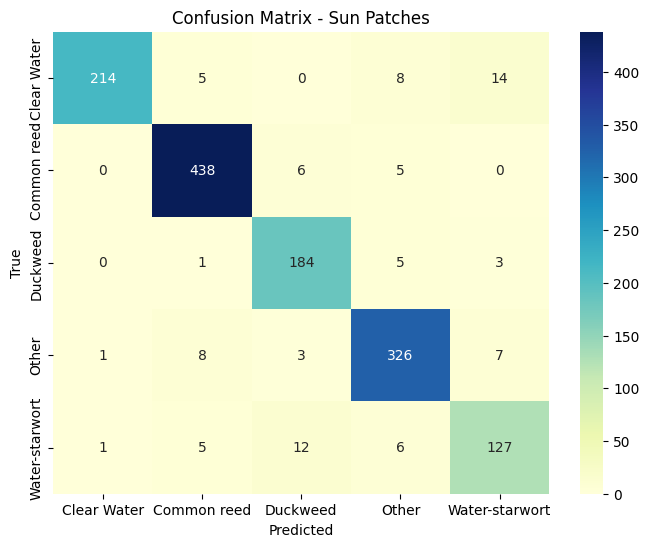


=== Confusion Matrix SCHADUW ===


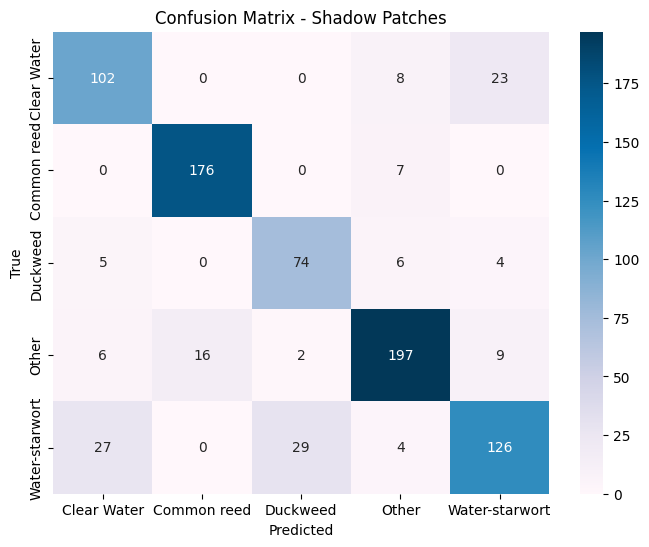

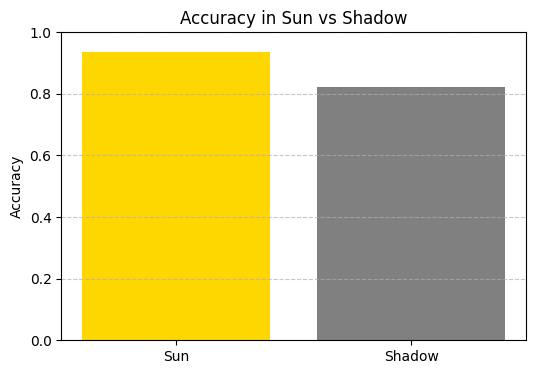

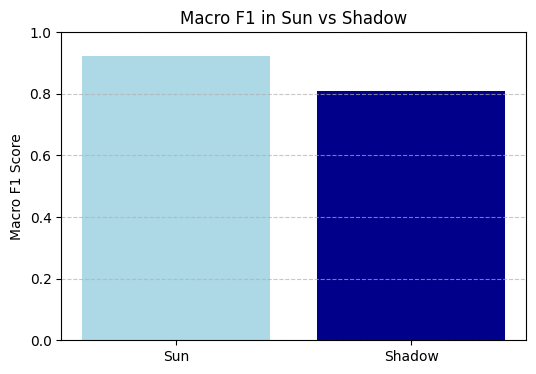

In [4]:
# ==========================================================================================
# 10. Confusion Matrix apart voor zon en schaduw patches
# ==========================================================================================

print("\n=== Confusion Matrix ZON ===")
cm_sun = confusion_matrix(sun_patches['true_label'], sun_patches['pred_label'], labels=labels_sorted)

plt.figure(figsize=(8,6))
sns.heatmap(cm_sun, annot=True, fmt='d', cmap='YlGnBu', 
            xticklabels=labels_sorted, yticklabels=labels_sorted)
plt.title('Confusion Matrix - Sun Patches')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

print("\n=== Confusion Matrix SCHADUW ===")
cm_shadow = confusion_matrix(shadow_patches['true_label'], shadow_patches['pred_label'], labels=labels_sorted)

plt.figure(figsize=(8,6))
sns.heatmap(cm_shadow, annot=True, fmt='d', cmap='PuBu', 
            xticklabels=labels_sorted, yticklabels=labels_sorted)
plt.title('Confusion Matrix - Shadow Patches')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# ==========================================================================================
# 11. Accuracy comparison plot zon vs schaduw
# ==========================================================================================

acc_per_condition = {
    'Sun': acc_sun,
    'Shadow': acc_shadow
}

plt.figure(figsize=(6,4))
plt.bar(acc_per_condition.keys(), acc_per_condition.values(), color=['gold', 'gray'])
plt.ylim(0,1)
plt.ylabel('Accuracy')
plt.title('Accuracy in Sun vs Shadow')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# ==========================================================================================
# 12. F1 Score comparison plot zon vs schaduw
# ==========================================================================================

f1_per_condition = {
    'Sun': macroF1_sun,
    'Shadow': macroF1_shadow
}

plt.figure(figsize=(6,4))
plt.bar(f1_per_condition.keys(), f1_per_condition.values(), color=['lightblue', 'darkblue'])
plt.ylim(0,1)
plt.ylabel('Macro F1 Score')
plt.title('Macro F1 in Sun vs Shadow')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


In [ ]:
# ==========================================================================================
# 13. Foute voorspellingen tonen: Clear Water → Water-starwort
# ==========================================================================================

# Filter fout geclassificeerde patches
errors_clearwater_waterstarwort = df[
    (df['true_label'] == 'Clear Water') &
    (df['pred_label'] == 'Water-starwort')
]

print(f"\nAantal fouten Clear Water -> Water-starwort: {len(errors_clearwater_waterstarwort)}")

# Verdeel in sun en shadow
errors_sun = errors_clearwater_waterstarwort[errors_clearwater_waterstarwort['light_condition_new'] == 'sun']
errors_shadow = errors_clearwater_waterstarwort[errors_clearwater_waterstarwort['light_condition_new'] == 'shadow']

# Toon 5 voorbeelden zon
print("\n=== Foute voorspellingen Clear Water → Water-starwort (ZON) ===")
for idx, row in errors_sun.sample(n=min(5, len(errors_sun)), random_state=42).iterrows():
    patch_name = row['patch_filename']
    brightness = row['brightness']

    # Zoek correcte afbeelding
    found = False
    for class_folder in os.listdir(TEST_PATCH_DIR):
        class_path = os.path.join(TEST_PATCH_DIR, class_folder)
        for img_file in os.listdir(class_path):
            if patch_name.split(".")[0] in img_file:
                img_path = os.path.join(class_path, img_file)
                img = Image.open(img_path)
                plt.imshow(img)
                plt.title(f"Patch: {patch_name}\nBrightness: {brightness:.1f} | Sun")
                plt.axis('off')
                plt.show()
                found = True
                break
        if found:
            break

# Toon 5 voorbeelden schaduw
print("\n=== Foute voorspellingen Clear Water → Water-starwort (SCHADUW) ===")
for idx, row in errors_shadow.sample(n=min(5, len(errors_shadow)), random_state=42).iterrows():
    patch_name = row['patch_filename']
    brightness = row['brightness']

    # Zoek correcte afbeelding
    found = False
    for class_folder in os.listdir(TEST_PATCH_DIR):
        class_path = os.path.join(TEST_PATCH_DIR, class_folder)
        for img_file in os.listdir(class_path):
            if patch_name.split(".")[0] in img_file:
                img_path = os.path.join(class_path, img_file)
                img = Image.open(img_path)
                plt.imshow(img)
                plt.title(f"Patch: {patch_name}\nBrightness: {brightness:.1f} | Shadow")
                plt.axis('off')
                plt.show()
                found = True
                break
        if found:
            break


In [6]:
import re

# Extracteer segment uit patch_filename
def extract_segment_from_filename(filename):
    match = re.match(r"(F\d+)_", filename)
    if match:
        return match.group(1)
    else:
        return "Unknown"

df['segment'] = df['patch_filename'].apply(extract_segment_from_filename)

print(df[['patch_filename', 'segment']].head(10))


        patch_filename segment
0  F2_0087_patch_0.jpg      F2
1  F2_0087_patch_1.jpg      F2
2  F2_0087_patch_2.jpg      F2
3  F2_0087_patch_3.jpg      F2
4  F2_0087_patch_4.jpg      F2
5  F2_0087_patch_5.jpg      F2
6  F2_0087_patch_6.jpg      F2
7  F2_0087_patch_7.jpg      F2
8  F2_0087_patch_8.jpg      F2
9  F2_0087_patch_9.jpg      F2



=== Foutenanalyse per segment ===
  segment  num_errors
8      F9          51
3     F18          38
5      F2          31
7     F23          28
1     F15          28
6     F21          22
4     F19          19
0     F13          15
2     F16           4


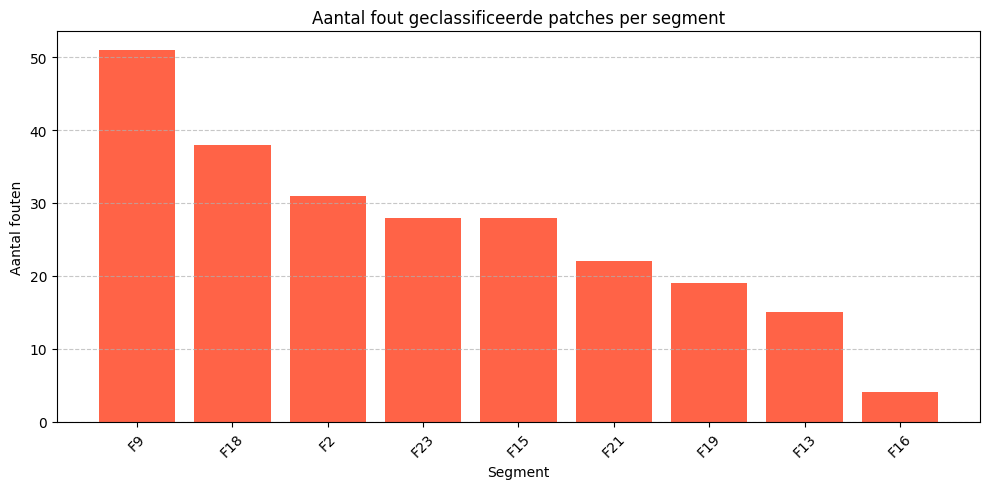


=== Gedetailleerde foutenanalyse per segment (ZON vs SCHADUW) ===
lighting  shadow  sun
segment              
F13            7    8
F15           19    9
F16            3    1
F18           29    9
F19            5   14
F2            27    4
F21            7   15
F23           17   11
F9            32   19


C:\Users\Sander\AppData\Local\Temp\ipykernel_1768\3229841377.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors_all['lighting'] = errors_all['light_condition_new']


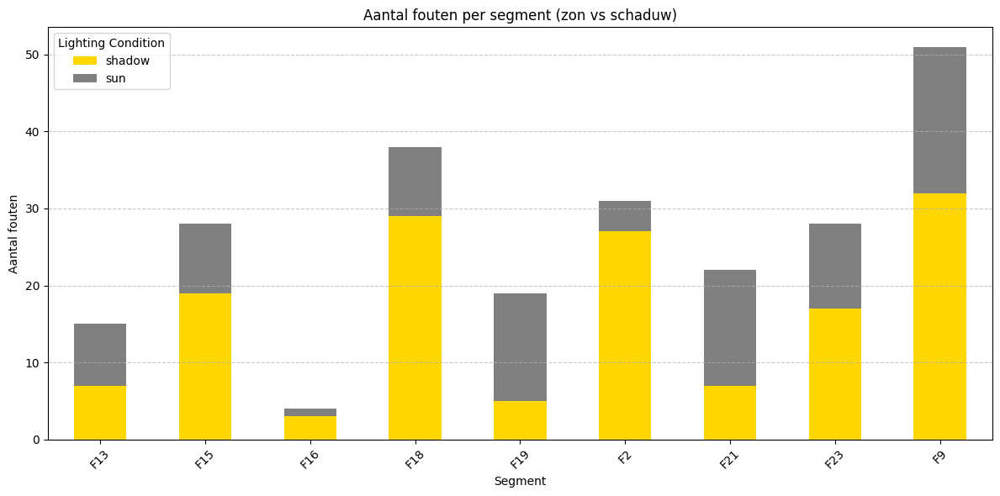

In [7]:
# ==========================================================================================
# 14. Aantal fouten per segment
# ==========================================================================================

print("\n=== Foutenanalyse per segment ===")

# Eerst: selecteer ALLE foute voorspellingen
errors_all = df[df['true_label'] != df['pred_label']]

# Groepeer fouten per segment
errors_per_segment = errors_all.groupby('segment').size().reset_index(name='num_errors')

# Sorteren op aantal fouten
errors_per_segment = errors_per_segment.sort_values(by='num_errors', ascending=False)

print(errors_per_segment)

# Plotten
plt.figure(figsize=(10,5))
plt.bar(errors_per_segment['segment'], errors_per_segment['num_errors'], color='tomato')
plt.xlabel('Segment')
plt.ylabel('Aantal fouten')
plt.title('Aantal fout geclassificeerde patches per segment')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# ==========================================================================================
# 15. Aantal fouten per segment onderverdeeld in zon/schaduw
# ==========================================================================================

print("\n=== Gedetailleerde foutenanalyse per segment (ZON vs SCHADUW) ===")

# Voeg een kolom toe: zon/schaduw
errors_all['lighting'] = errors_all['light_condition_new']

# Groepeer fouten per segment én lichtconditie
errors_segment_light = errors_all.groupby(['segment', 'lighting']).size().unstack(fill_value=0)

print(errors_segment_light)

# Stacked bar plot
errors_segment_light.plot(kind='bar', stacked=True, figsize=(12,6), color=['gold', 'gray'])
plt.xlabel('Segment')
plt.ylabel('Aantal fouten')
plt.title('Aantal fouten per segment (zon vs schaduw)')
plt.xticks(rotation=45)
plt.legend(title='Lighting Condition')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


Aantal overgebleven patches na filteren F9: 1870
Aantal fouten in dataset: 185
Fouten in zonlicht: 71
Fouten in schaduw: 114

== Errors in Sunlight ==


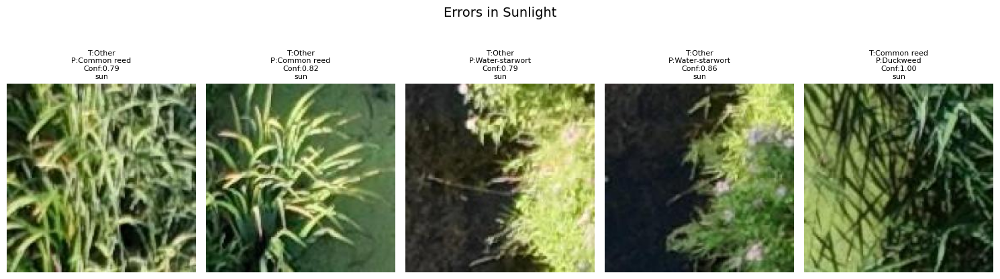

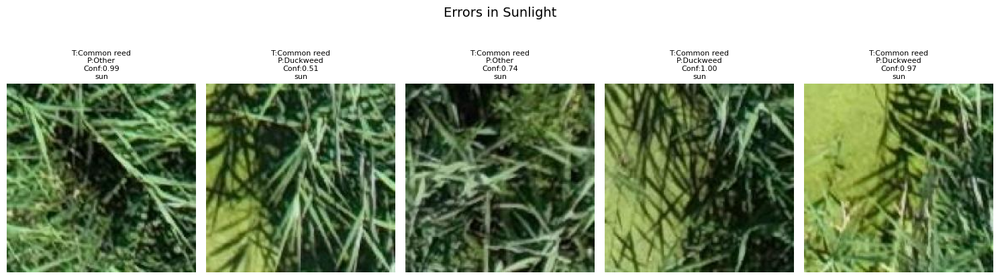

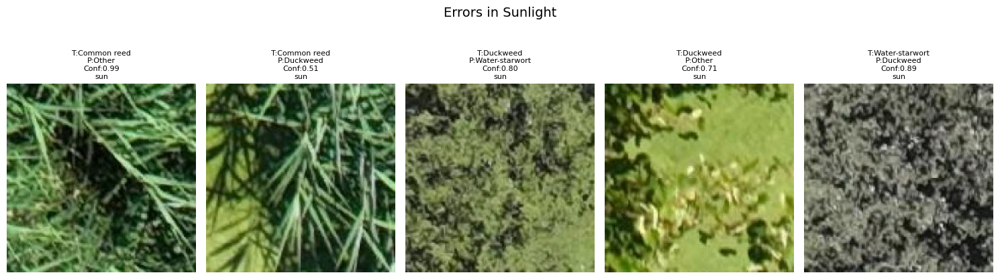

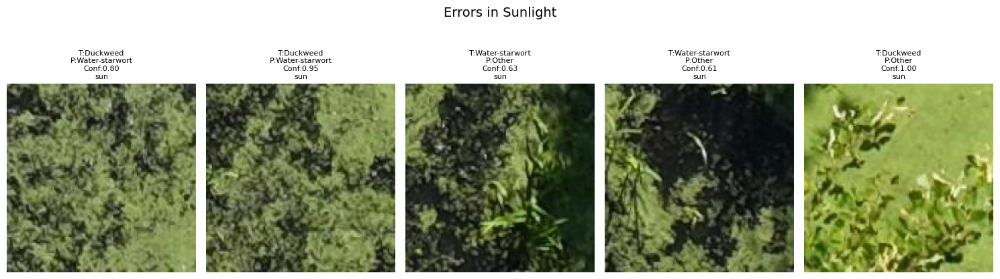

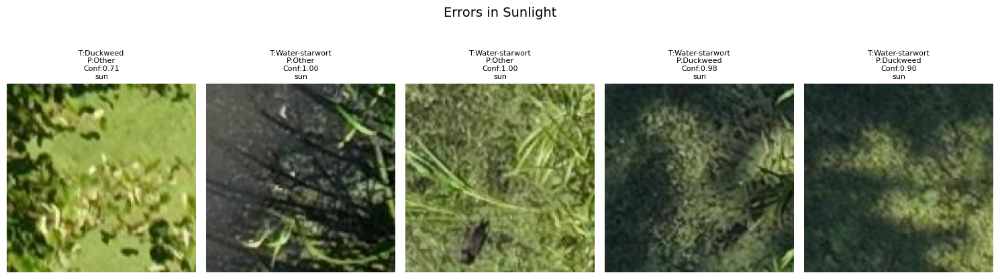

...

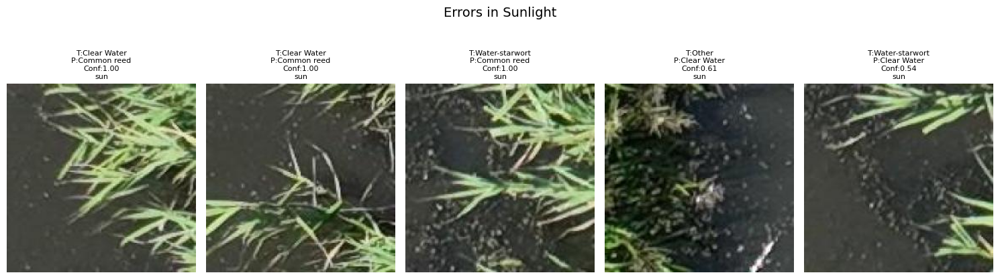

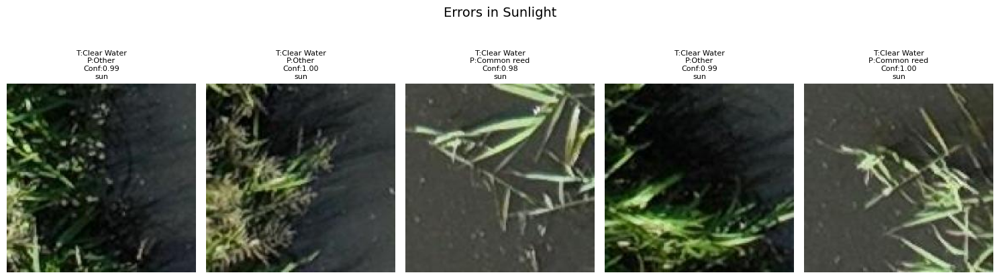

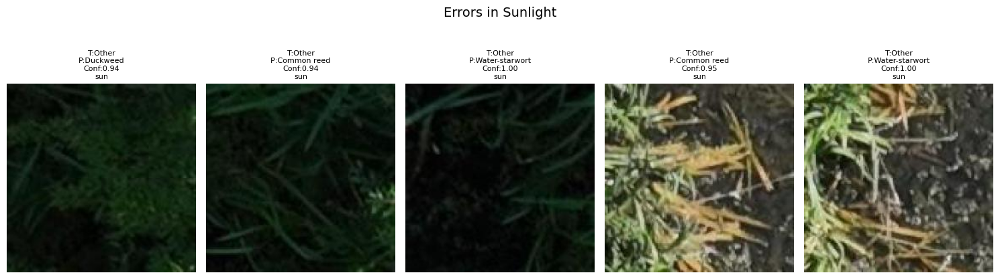

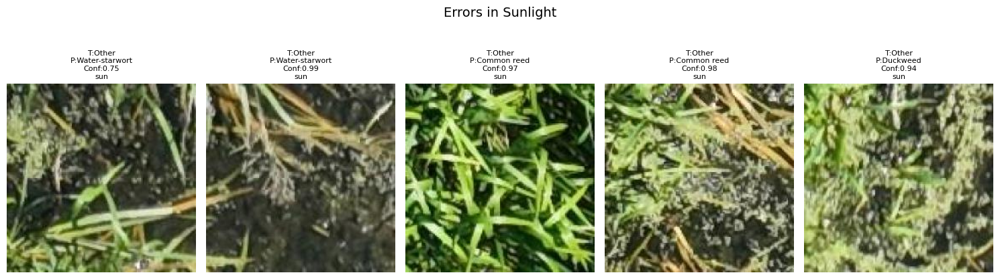

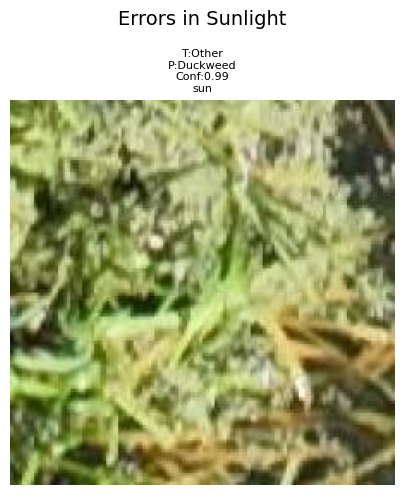


== Errors in Shadow ==


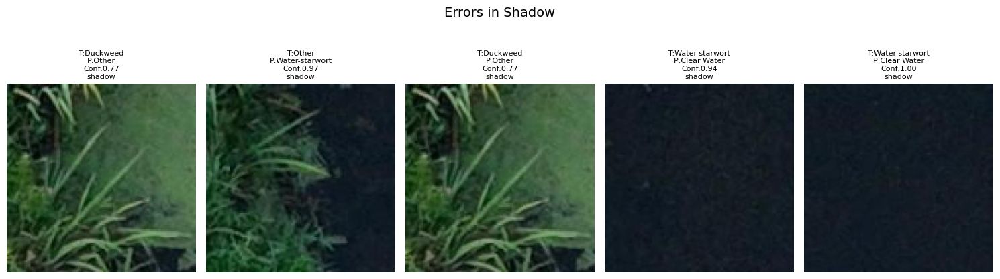

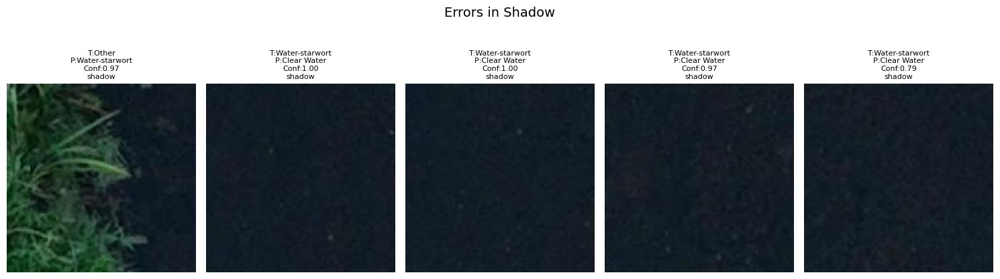

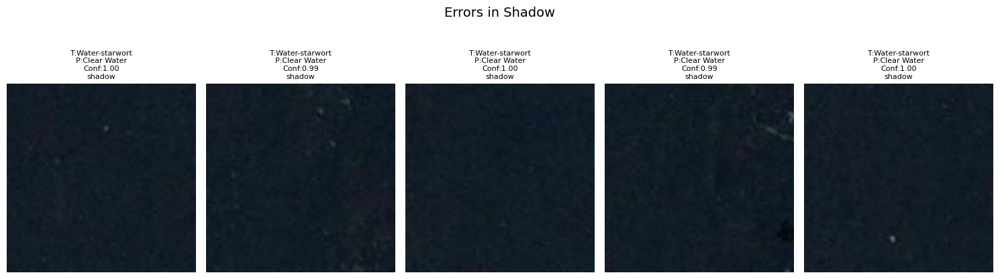

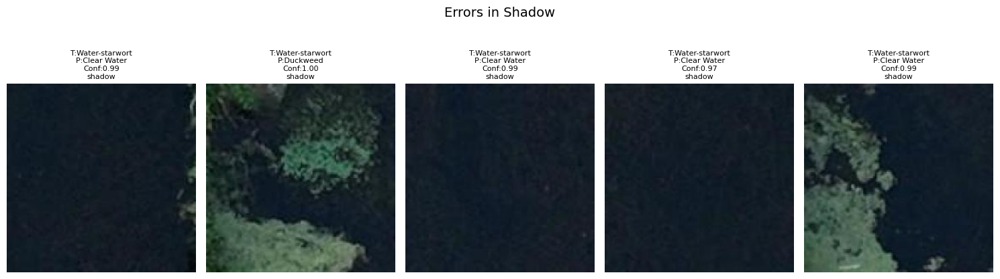

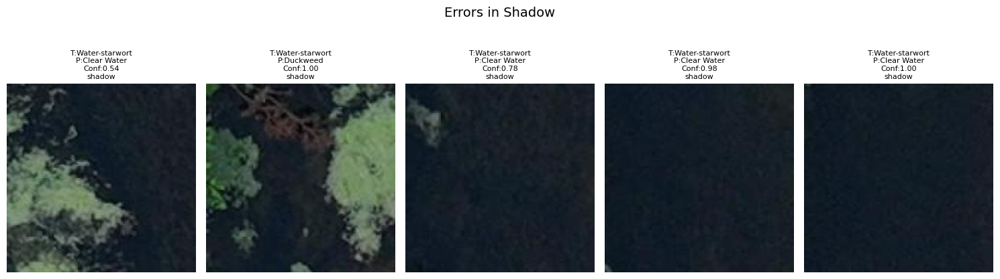

...

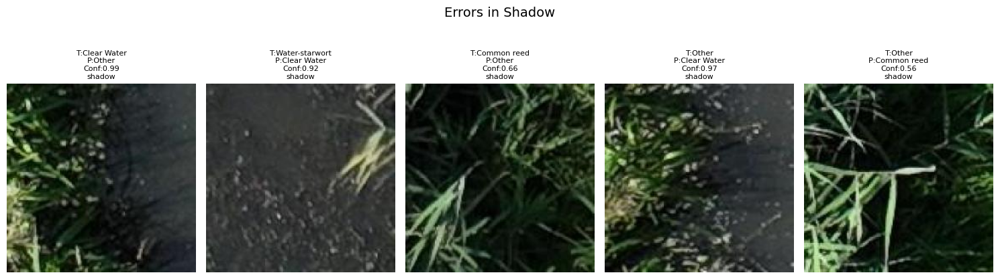

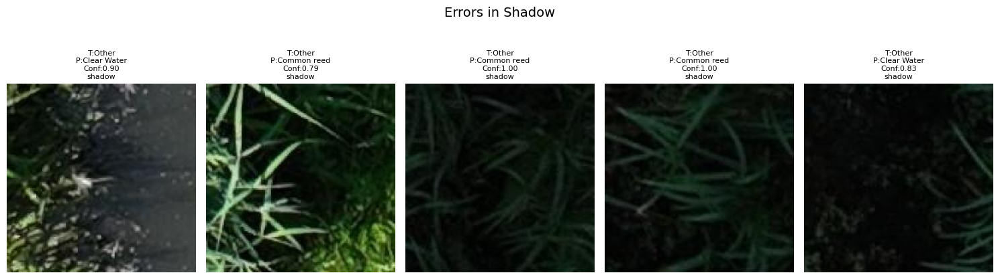

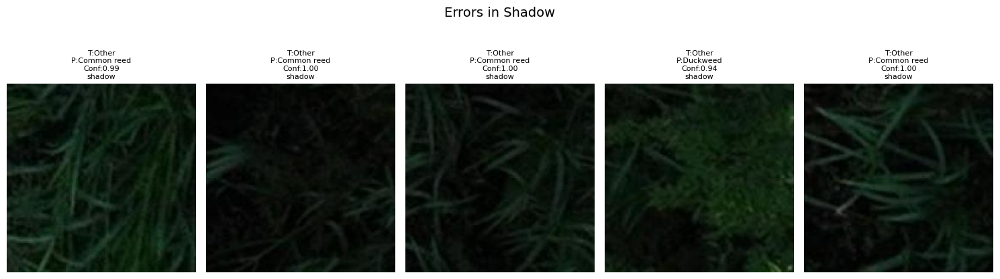

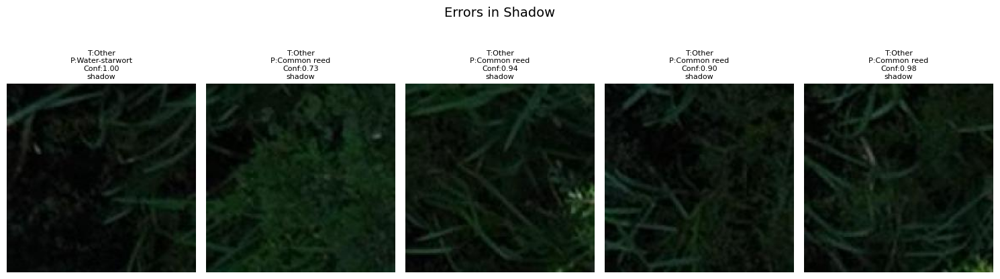

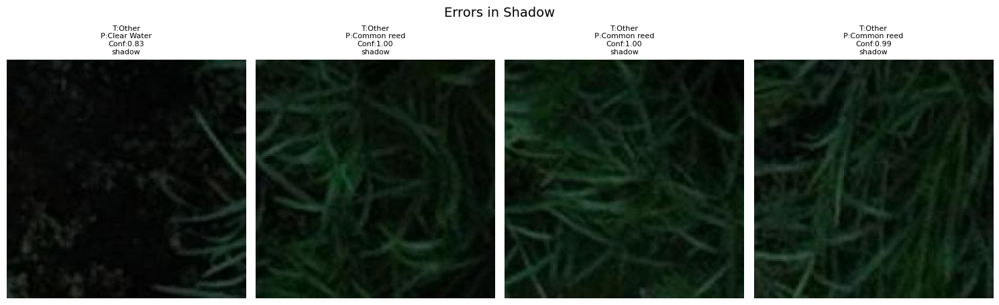

In [8]:
import matplotlib.pyplot as plt
import os
from PIL import Image
import pandas as pd

# === 1. Laad predictions ===
df_results = pd.read_csv("predictions_output.csv")

# === 2. Voeg segment toe uit patch_filename ===
import re
def extract_segment_from_filename(filename):
    match = re.match(r"(F\d+)_", filename)
    if match:
        return match.group(1)
    else:
        return "Unknown"

df_results['segment'] = df_results['patch_filename'].apply(extract_segment_from_filename)

# === 3. Filter F9 eruit ===
df_filtered = df_results[df_results['segment'] != "F9"]

print(f"Aantal overgebleven patches na filteren F9: {len(df_filtered)}")

# === 4. Definieer fouten: true_label ≠ pred_label ===
errors_all = df_filtered[df_filtered['true_label'] != df_filtered['pred_label']]

print(f"Aantal fouten in dataset: {len(errors_all)}")

# === 5. Verdeel fouten op basis van light condition (sun/shadow) ===
errors_sun = errors_all[errors_all['light_condition_new'] == "sun"]
errors_shadow = errors_all[errors_all['light_condition_new'] == "shadow"]

print(f"Fouten in zonlicht: {len(errors_sun)}")
print(f"Fouten in schaduw: {len(errors_shadow)}")

# === 6. Patches tonen ===

TEST_PATCH_DIR = r"C:\Users\Sander\OneDrive - UGent\Semester_2\Masterproef\Thesis_ML\Roboflow\Raw_July\Testing data\test"

def show_error_images(errors_df, title, n_per_batch=5):
    print(f"\n== {title} ==")

    for i in range(0, len(errors_df), n_per_batch):
        batch = errors_df.iloc[i:i+n_per_batch]

        fig, axs = plt.subplots(1, len(batch), figsize=(15, 5))

        if len(batch) == 1:
            axs = [axs]

        for ax, (_, row) in zip(axs, batch.iterrows()):
            patch_filename = row['patch_filename']
            true_label = row['true_label']
            pred_label = row['pred_label']
            confidence = row['confidence']
            light_cond = row['light_condition_new']

            # Zoek het juiste pad
            found = False
            for class_folder in os.listdir(TEST_PATCH_DIR):
                class_path = os.path.join(TEST_PATCH_DIR, class_folder)
                for img_file in os.listdir(class_path):
                    if patch_filename.split(".")[0] in img_file:
                        img_path = os.path.join(class_path, img_file)
                        image = Image.open(img_path)
                        ax.imshow(image)
                        ax.set_title(f"T:{true_label}\nP:{pred_label}\nConf:{confidence:.2f}\n{light_cond}", fontsize=8)
                        ax.axis('off')
                        found = True
                        break
                if found:
                    break

        plt.suptitle(title, fontsize=14)
        plt.tight_layout()
        plt.show()

# === 7. Toon foutbeelden ===
show_error_images(errors_sun, "Errors in Sunlight")
show_error_images(errors_shadow, "Errors in Shadow")


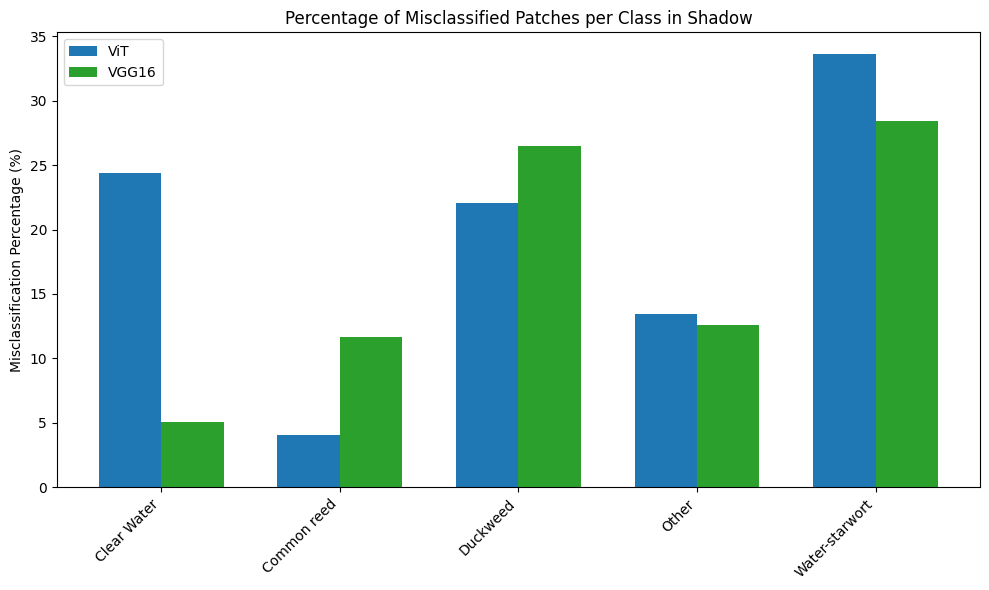

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

# ─── 0. CONFIG ───────────────────────────────────────────────────────────────
vit_csv = r"C:\Users\Sander\OneDrive - UGent\Semester_2\Masterproef\Thesis_ML\Roboflow\Raw_July\All_results\ViT\metadata_full_July_updated.csv"
vgg_csv = r"C:\Users\Sander\OneDrive - UGent\Semester_2\Masterproef\Thesis_ML\Roboflow\Raw_July\All_results\vgg16\predictions_output_vgg16.csv"
out_fig = r"C:\Users\Sander\OneDrive - UGent\Semester_2\Masterproef\Thesis_ML\Roboflow\Raw_July\All_results\Figuren\misclassification_comparison.png"  # <-- Output figuur pad
os.makedirs(os.path.dirname(out_fig), exist_ok=True)

# the five classes in your dataset, in the desired order
classes = ["Clear Water","Common reed","Duckweed","Other","Water-starwort"]

# ─── 1. LOAD & PREPARE ───────────────────────────────────────────────────────
df_vit = pd.read_csv(vit_csv)
df_vgg = pd.read_csv(vgg_csv)

# rename VGG16’s light‐column to match ViT’s
df_vgg = df_vgg.rename(columns={"light_condition_new":"light_condition"})

# keep only the shadow patches
vit_sh = df_vit[df_vit["light_condition"] == "shadow"]
vgg_sh = df_vgg[df_vgg["light_condition"] == "shadow"]

# ─── 2. COMPUTE MISCLASSIFICATION PERCENTAGES ────────────────────────────────
def mis_pct(df_shadow):
    pct = {}
    for cls in classes:
        total = len(df_shadow[df_shadow["true_label"] == cls])
        if total > 0:
            wrong = len(df_shadow[
                (df_shadow["true_label"] == cls) &
                (df_shadow["pred_label"] != cls)
            ])
            pct[cls] = (wrong / total) * 100
        else:
            pct[cls] = np.nan
    return pct

pct_vit = mis_pct(vit_sh)
pct_vgg = mis_pct(vgg_sh)

# assemble into a DataFrame for plotting
plot_df = pd.DataFrame({
    "class":   classes,
    "ViT":     [pct_vit[c] for c in classes],
    "VGG16":   [pct_vgg[c] for c in classes]
})

# ─── 3. PLOT ────────────────────────────────────────────────────────────────
palette = {"vgg16":"#2ca02c", "ViT":"#1f77b4"}

x = np.arange(len(classes))
width = 0.35

fig, ax = plt.subplots(figsize=(10,6))
ax.bar(x - width/2, plot_df["ViT"],   width, label="ViT",   color=palette["ViT"])
ax.bar(x + width/2, plot_df["VGG16"], width, label="VGG16", color=palette["vgg16"])

ax.set_xticks(x)
ax.set_xticklabels(classes, rotation=45, ha="right")
ax.set_ylabel("Misclassification Percentage (%)")
ax.set_title("Percentage of Misclassified Patches per Class in Shadow")
ax.legend()

plt.tight_layout()
plt.savefig(out_fig, dpi=300)
plt.show()
